In [2]:
import mediapipe as mp
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt

import warnings

warnings.filterwarnings("ignore", category=UserWarning, module="sklearn")


In [3]:
#Khởi tạo mediapie
mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose

#Hàm tính khoảng cách

In [47]:
from math import sqrt

# rescale frame 1/2
def rescale_frame(frame, percent=50):
    '''
    Rescale a frame to a certain percentage compare to its original frame
    '''
    width = int(frame.shape[1] * percent/ 100)
    height = int(frame.shape[0] * percent/ 100)
    dim = (width, height)
    return cv2.resize(frame, dim, interpolation =cv2.INTER_AREA)

#Tính khoảng cách giữa 2 điểm trong không gian 2D
def calculate_distance(pointX, pointY) -> float:
    '''
    Calculate a distance between 2 points
    '''

    x1, y1 = pointX
    x2, y2 = pointY

    return sqrt((x2 - x1) ** 2 + (y2 - y1) ** 2)

#Tính góc giữa 3 điểm trong không gian 3D
def calculate_angle(pointA, pointB, pointC) -> float:
    """
    Tính góc giữa ba điểm trong không gian 3D (đơn vị: độ)
    a, b, c là danh sách chứa tọa độ 3D: [x, y, z]
    """
    A = np.array(pointA)
    B = np.array(pointB)
    C = np.array(pointC)

    # Vector BA và BC
    BA = A - B
    BC = C - B

    # Tính tích vô hướng
    dot_product = np.dot(BA, BC)
    
    # Tính độ dài vector
    norm_BA = np.linalg.norm(BA)
    norm_BC = np.linalg.norm(BC)

    # Tính góc bằng công thức cos(theta) = (A.B) / (|A| * |B|)
    cos_theta = dot_product / (norm_BA * norm_BC)
    
    # Chuyển từ radian sang độ
    angle = np.degrees(np.arccos(np.clip(cos_theta, -1.0, 1.0)))

    return angle

def midpoint(point1, point2):
    """
    Tính điểm trung bình giữa hai điểm trong không gian 3D.
    """
    x_mid = (point1[0] + point2[0]) / 2
    y_mid = (point1[1] + point2[1]) / 2

    return (x_mid, y_mid)


test

In [5]:
import numpy as np

# Tọa độ có z khác 0
pointA = (1, 0, 1)
pointB = (0, 0, 0)
pointC = (0, 1, 2)

angle = calculate_angle(pointA, pointB, pointC)
print(f"Góc giữa 3 điểm là: {angle:.2f} độ") # 50.77 độ 


Góc giữa 3 điểm là: 50.77 độ


## 4. Xuống quá xâu 
Góc giữa hông, vai, đầu gối nhỏ 


In [6]:
#Chọn các điểm cần lấy
Important_kp = [
    "NOSE",
    "LEFT_SHOULDER",
    "RIGHT_SHOULDER",
    "LEFT_HIP",
    "RIGHT_HIP",
    "LEFT_KNEE",
    "RIGHT_KNEE",
    "LEFT_ANKLE",
    "RIGHT_ANKLE",
]

#Tạo header cho dataframe
header = ["label"]

for kp in Important_kp:
    header.extend([f"{kp}_x", f"{kp}_y", f"{kp}_z", f"{kp}_visibility"])

header

['label',
 'NOSE_x',
 'NOSE_y',
 'NOSE_z',
 'NOSE_visibility',
 'LEFT_SHOULDER_x',
 'LEFT_SHOULDER_y',
 'LEFT_SHOULDER_z',
 'LEFT_SHOULDER_visibility',
 'RIGHT_SHOULDER_x',
 'RIGHT_SHOULDER_y',
 'RIGHT_SHOULDER_z',
 'RIGHT_SHOULDER_visibility',
 'LEFT_HIP_x',
 'LEFT_HIP_y',
 'LEFT_HIP_z',
 'LEFT_HIP_visibility',
 'RIGHT_HIP_x',
 'RIGHT_HIP_y',
 'RIGHT_HIP_z',
 'RIGHT_HIP_visibility',
 'LEFT_KNEE_x',
 'LEFT_KNEE_y',
 'LEFT_KNEE_z',
 'LEFT_KNEE_visibility',
 'RIGHT_KNEE_x',
 'RIGHT_KNEE_y',
 'RIGHT_KNEE_z',
 'RIGHT_KNEE_visibility',
 'LEFT_ANKLE_x',
 'LEFT_ANKLE_y',
 'LEFT_ANKLE_z',
 'LEFT_ANKLE_visibility',
 'RIGHT_ANKLE_x',
 'RIGHT_ANKLE_y',
 'RIGHT_ANKLE_z',
 'RIGHT_ANKLE_visibility']

In [48]:
#Đọc dữ liệu từ frame trả về points
def extract_important_keypoints(results) -> list:
    '''
    Extract important keypoints from mediapipe pose detection
    '''
    landmarks = results.pose_landmarks.landmark

    # # Lấy Z của NOSE và HIP làm chuẩn
    nose_z = landmarks[mp_pose.PoseLandmark.NOSE.value].z
    hip_z = landmarks[mp_pose.PoseLandmark.LEFT_HIP.value].z
    scale_factor = abs(nose_z - hip_z) if abs(nose_z - hip_z) > 0 else 1  # Tránh chia cho 0

    # # Hàm chuẩn hóa Z theo khoảng cách mũi, hông
    def rescale_z(z):
        return (z - nose_z) / scale_factor

    data = []
    for lm in Important_kp:
        keypoint = landmarks[mp_pose.PoseLandmark[lm].value]
        data.append([keypoint.x, keypoint.y, rescale_z(keypoint.z), keypoint.visibility])
        # data.append([keypoint.x, keypoint.y, keypoint.z, keypoint.visibility])
    
    return np.array(data).flatten().tolist()


Xem data chuẩn

In [49]:
#Làm sạch dữ liệu dataframe trước khi thêm dữ liệu mới
# df = pd.DataFrame(columns=["video", "shoulder_y", "hip_y", "knee_y"])
df = pd.DataFrame(columns=["video", "hip_knee", "hip_ankle"])
df 

,video,hip_knee,hip_ankle


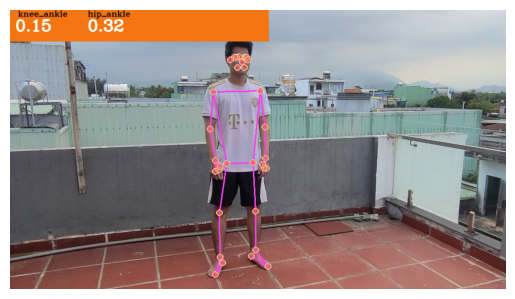

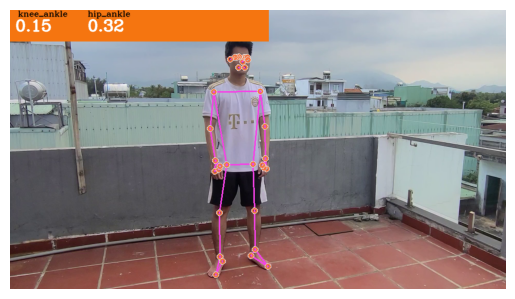

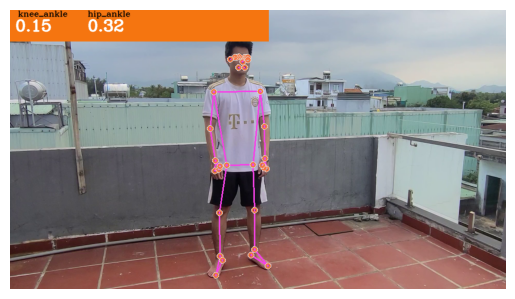

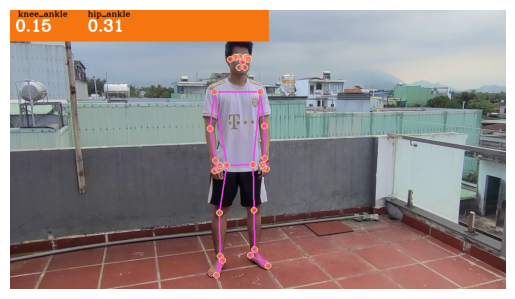

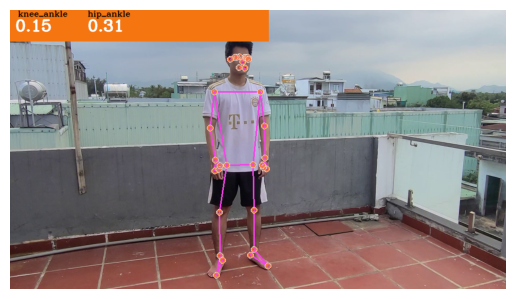

...

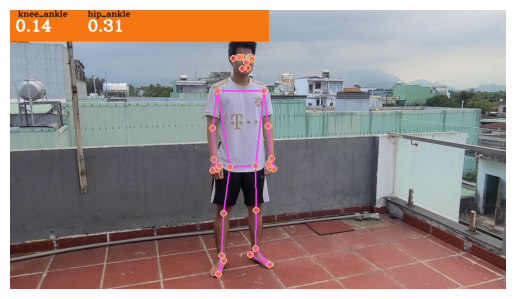

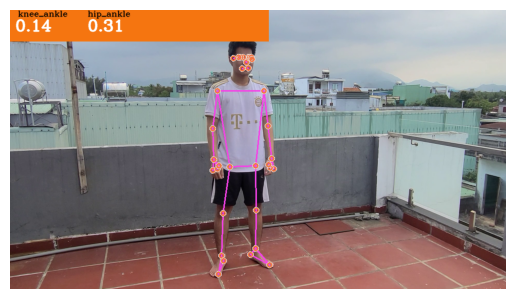

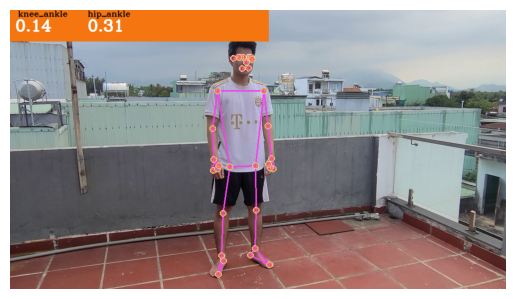

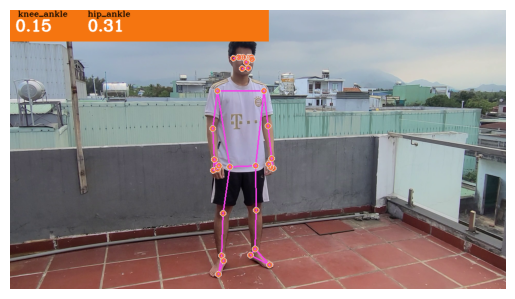

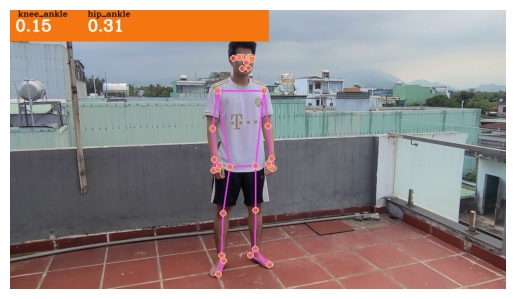

In [52]:
#Xử lý từng video để tính khoảng cách chân, đàu gốin 
def process_frame(Video_folder, Video_name):
    
    Cap = cv2.VideoCapture(f"{Video_folder}/{Video_name}")

    with mp_pose.Pose(min_detection_confidence=0.5, min_tracking_confidence=0.5) as pose:
        while Cap.isOpened():
            ret, image = Cap.read()

            if not ret:
                break

            # Chuyển ảnh sang RGB
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = rescale_frame(image, percent=50)
            image.flags.writeable = True  # Make the image writable

            #trích xuất kpkp
            results = pose.process(image)

            # Kiểm tra có nhận được keypoint không
            if not results.pose_landmarks:
                continue
            
            # Chuyển lại ảnh sang BGR để hiển thị
            # image.flags.writeable = True
            # image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

            #khởi tạo biến tính
            hip_knee = 0
            hip_ankle = 0

            
            try:
                # Lấy kp từ frame
                row = extract_important_keypoints(results)
                X = pd.DataFrame([row], columns=header[1:])

                # Tinhs toán và so sánh góc giữa 2 đầu gối
                landmarks = results.pose_landmarks.landmark

                #Chuẩn hóa z theo nose và hip

                #Điểm trung bình đầu gối
                left_knee  = [landmarks[mp_pose.PoseLandmark.LEFT_KNEE.value].x, landmarks[mp_pose.PoseLandmark.LEFT_KNEE.value].y]
                right_knee = [landmarks[mp_pose.PoseLandmark.RIGHT_KNEE.value].x, landmarks[mp_pose.PoseLandmark.RIGHT_KNEE.value].y]

                knee = midpoint(left_knee, right_knee)

                #Điểm trung bình hông
                left_hip  = [landmarks[mp_pose.PoseLandmark.LEFT_HIP.value].x, landmarks[mp_pose.PoseLandmark.LEFT_HIP.value].y]
                right_hip = [landmarks[mp_pose.PoseLandmark.RIGHT_HIP.value].x, landmarks[mp_pose.PoseLandmark.RIGHT_HIP.value].y]

                hip = midpoint(left_hip, right_hip)

                #Điểm trung bình vai
                left_shoulder  = [landmarks[mp_pose.PoseLandmark.LEFT_SHOULDER.value].x, landmarks[mp_pose.PoseLandmark.LEFT_SHOULDER.value].y]
                right_shoulder = [landmarks[mp_pose.PoseLandmark.RIGHT_SHOULDER.value].x, landmarks[mp_pose.PoseLandmark.RIGHT_SHOULDER.value].y]

                shoulder = midpoint(left_shoulder, right_shoulder)

                #Điểm trung bình chân
                left_ankle  = [landmarks[mp_pose.PoseLandmark.LEFT_ANKLE.value].x, landmarks[mp_pose.PoseLandmark.LEFT_ANKLE.value].y]
                right_ankle = [landmarks[mp_pose.PoseLandmark.RIGHT_ANKLE.value].x, landmarks[mp_pose.PoseLandmark.RIGHT_ANKLE.value].y]

                ankle = midpoint(left_ankle, right_ankle)

                #Khoảng cách chân  - đầu gối
                knee_ankle = calculate_distance(ankle, knee)

                #Khoảng cách hông - chân
                hip_ankle = calculate_distance(hip, ankle)

                # Nền
                cv2.rectangle(image, (0, 0), (500, 60), (245, 117, 16), -1)

                # Display hip_knee 
                cv2.putText(image, "knee_ankle", (15, 12), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
                cv2.putText(image, str(round(knee_ankle, 2)), (10, 40), cv2.FONT_HERSHEY_COMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)

                # Display knee
                cv2.putText(image, "hip_ankle", (150, 12), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
                cv2.putText(image, str(round(hip_ankle, 2)), (150, 40), cv2.FONT_HERSHEY_COMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)

            except Exception as e:
                print(f"Error: {e}")

            # Draw landmarks and connections
            mp_drawing.draw_landmarks(image, results.pose_landmarks, mp_pose.POSE_CONNECTIONS, mp_drawing.DrawingSpec(color=(244, 117, 66), thickness=2, circle_radius=4), mp_drawing.DrawingSpec(color=(245, 66, 230), thickness=2, circle_radius=2))

            df.loc[len(df)] = [Video_name, hip_knee, hip_ankle]

            # Hiển thị ảnh
            plt.imshow(image)
            plt.axis("off")  # Ẩn trục tọa độ
            plt.show()

        Cap.release()

# Đường dẫn thư mục chứa video
video_folder = "Data/Train/Correct"
video_files = "20250228_150821.mp4"

# video_folder = "Data/Train/Gap_lung"
# video_files = "20250228_165326.mp4"

# video_folder = "Data/Train/Xuong_qua_xau"
# video_files = "20250228_163416.mp4"

process_frame(video_folder, video_files)


In [45]:
import os

# Đường dẫn thư mục chứa video
video_folder = "Data/Train/Correct"
# video_folder = "Data/Train/Xuong_qua_xau"
# video_folder = "Data/Train/Gap_lung"
video_files = [f for f in os.listdir(video_folder) if f.endswith(".mp4")]

# df = pd.DataFrame(columns=["video", "shoulder_y", "hip_y", "knee_y"])
df = pd.DataFrame(columns=["Video", "hip_knee", "hip_ankle"])

for video in video_files:
    process_frame(video_folder, video)

Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: list index out of range
Error: l

KeyboardInterrupt: 

In [22]:
df 

,video,shoulder_y,hip_y,knee_y
0,20250228_093014000_iOS.mp4,0.461408,0.686007,0.723767
1,20250228_093014000_iOS.mp4,0.461287,0.688465,0.723798
2,20250228_093014000_iOS.mp4,0.461236,0.689842,0.724399
3,20250228_093014000_iOS.mp4,0.461440,0.690954,0.724949
4,20250228_093014000_iOS.mp4,0.461343,0.691330,0.725700
...,...,...,...,...
1612,VID_20250228_163638.mp4,0.477651,0.670897,0.759114
1613,VID_20250228_163638.mp4,0.474497,0.668572,0.758597
1614,VID_20250228_163638.mp4,0.471724,0.665891,0.757853
1615,VID_20250228_163638.mp4,0.468840,0.663494,0.755677


In [23]:
#Tính toán tỉ lệ giữa vai và chân
df["ratio_hip_knee"] = df["hip_y"] / df["knee_y"]
df["ratio_shoulder_hip"] = df["shoulder_y"] / df["hip_y"]
df

,video,shoulder_y,hip_y,knee_y,ratio_hip_knee,ratio_shoulder_hip
0,20250228_093014000_iOS.mp4,0.461408,0.686007,0.723767,0.947827,0.672599
1,20250228_093014000_iOS.mp4,0.461287,0.688465,0.723798,0.951184,0.670021
2,20250228_093014000_iOS.mp4,0.461236,0.689842,0.724399,0.952296,0.668611
3,20250228_093014000_iOS.mp4,0.461440,0.690954,0.724949,0.953107,0.667830
4,20250228_093014000_iOS.mp4,0.461343,0.691330,0.725700,0.952640,0.667326
...,...,...,...,...,...,...
1612,VID_20250228_163638.mp4,0.477651,0.670897,0.759114,0.883789,0.711958
1613,VID_20250228_163638.mp4,0.474497,0.668572,0.758597,0.881327,0.709717
1614,VID_20250228_163638.mp4,0.471724,0.665891,0.757853,0.878655,0.708411
1615,VID_20250228_163638.mp4,0.468840,0.663494,0.755677,0.878013,0.706622


In [24]:
#Phân tích bộ data
df.describe()


,shoulder_y,hip_y,knee_y,ratio_hip_knee,ratio_shoulder_hip
count,1617.000000,1617.000000,1617.000000,1617.000000,1617.000000
mean,0.500100,0.697176,0.725950,0.959493,0.712713
std,0.089041,0.078743,0.045492,0.082882,0.075701
min,0.145812,0.457775,0.614041,0.676444,0.318523
25%,0.461440,0.648958,0.698483,0.905353,0.684844
50%,0.518018,0.705363,0.730753,0.966979,0.731282
75%,0.557727,0.763953,0.763637,1.025850,0.761321
max,0.641668,0.819108,0.792688,1.095421,0.804870


In [54]:
#test
df_false = df[(df["knee_angle"] < 122)]
df_false 


,video,knee_angle,hip_angle,ratio
0,20250228_162937.mp4,114.221551,121.734974,0.938280
1,20250228_162937.mp4,106.892224,114.510218,0.933473
2,20250228_162937.mp4,101.036225,108.772465,0.928877
3,20250228_162937.mp4,95.384067,103.154558,0.924671
4,20250228_162937.mp4,92.085490,99.815675,0.922555
...,...,...,...,...
1025,VID_20250228_163638.mp4,100.364638,106.149115,0.945506
1026,VID_20250228_163638.mp4,106.547887,112.111990,0.950370
1027,VID_20250228_163638.mp4,111.115537,116.412033,0.954502
1028,VID_20250228_163638.mp4,114.921887,119.995514,0.957718


In [55]:
df_false.describe()

,knee_angle,hip_angle,ratio
count,587.000000,587.000000,587.000000
mean,66.952520,75.985434,0.859566
std,30.736467,30.836746,0.061352
min,27.493294,37.203326,0.736440
25%,38.945380,47.706132,0.817368
50%,60.427389,69.065725,0.871875
75%,95.821093,105.239688,0.910459
max,121.927526,132.853157,0.960798


# Kết luận:
